In [23]:
# import tensorflow as tf

# # # Check for available GPUs
# # gpus = tf.config.list_physical_devices('GPU')

# # if gpus:
# #     print("GPU(s) found:")
# #     for gpu in gpus:
# #         print(f"- {gpu.name}")
# # else:
# #     print("No GPU(s) detected.")

# tf.config.experimental.set_memory_growth(tf.config.experimental.list_physical_devices('GPU')[0], True)

In [24]:
import os
from IPython.display import display, Image
import random
import numpy as np
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras import layers, models
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array

LOAD DATA


In [25]:
data=tf.keras.utils.image_dataset_from_directory('./categories')

Found 634 files belonging to 4 classes.


In [26]:
data

<BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [27]:
train_data_dir = './categories'

# Set the desired image size (e.g., 128x128)
desired_image_size = (256, 256)

# Use image_dataset_from_directory to create a labeled dataset
data = tf.keras.utils.image_dataset_from_directory(
    train_data_dir,
    batch_size=16,               # Adjust batch size as needed
    image_size=desired_image_size,  # Specify the desired image size
    shuffle=True,                # Shuffle the dataset
    seed=123                     # Set seed for reproducibility
)

Found 634 files belonging to 4 classes.


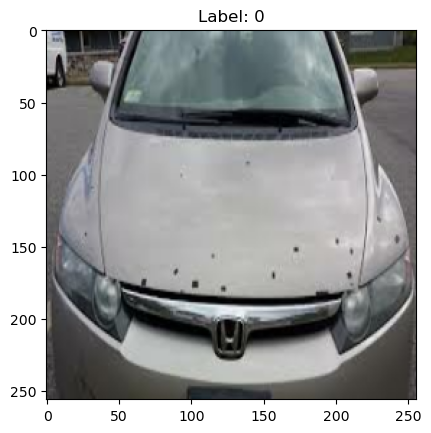

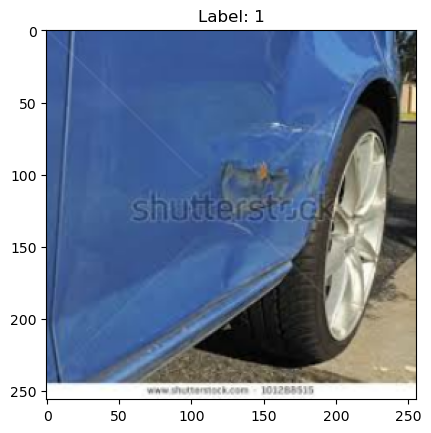

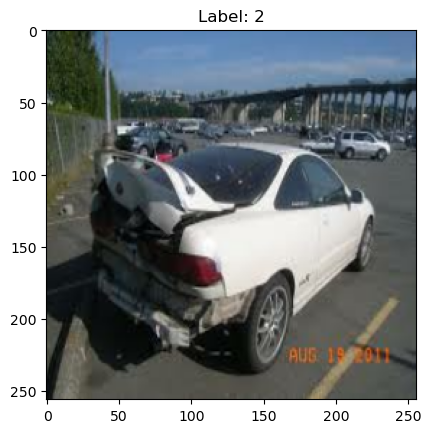

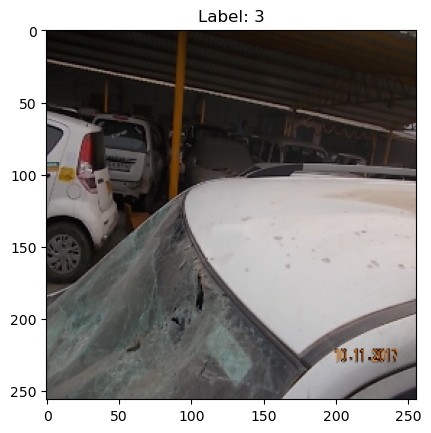

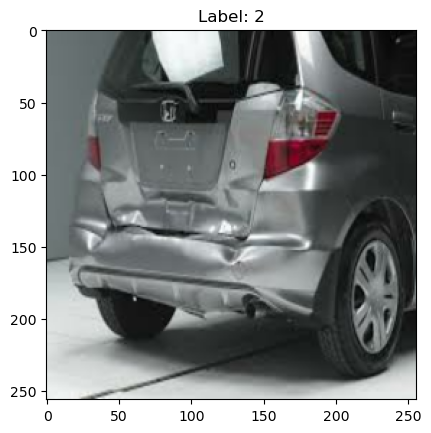

...

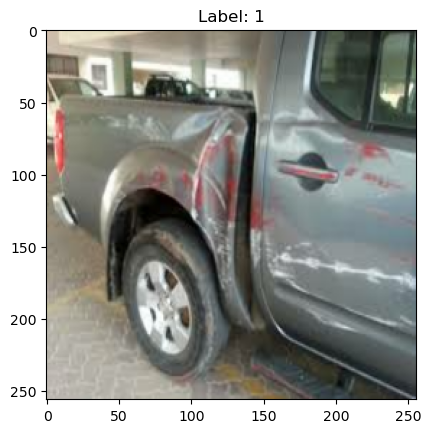

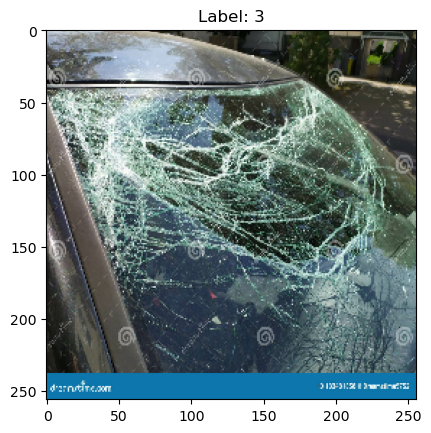

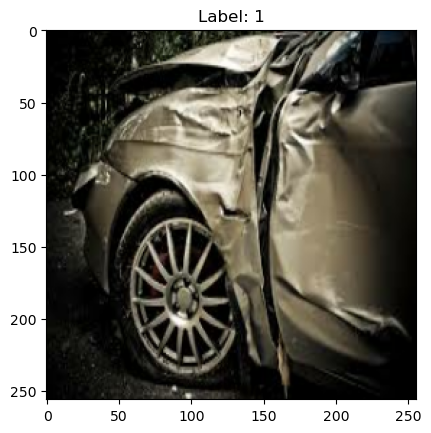

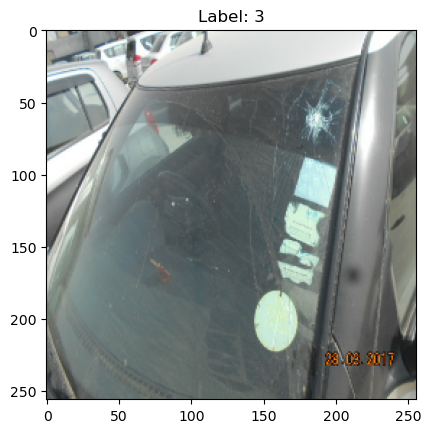

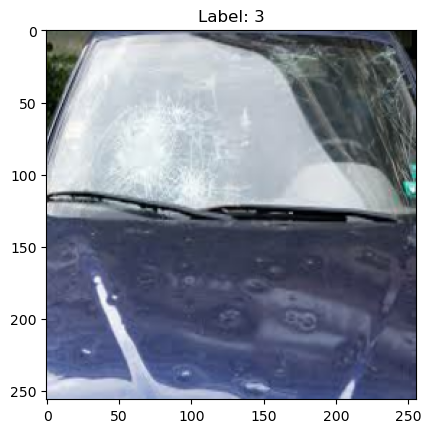

In [28]:
# for element in data:
#     images, labels = element
#     for i in range(len(images)):
#         # Assuming you are using matplotlib to display images
#         plt.imshow(images[i].numpy().astype("uint8"))
#         plt.title(f"Label: {labels[i].numpy()}")
#         plt.show()

# Counter to keep track of the number of images printed
# Define a dictionary to keep track of the number of images shown for each class
num_images_shown_per_class = {}

# Iterate through the dataset and print only the first 10 images from each class
for images, labels in data:
    for i in range(len(images)):
        label = labels[i].numpy()
        
        # Check if the current label exists in the dictionary
        if label not in num_images_shown_per_class:
            num_images_shown_per_class[label] = 0
        
        # Display the image using matplotlib if fewer than 10 images have been shown for this class
        if num_images_shown_per_class[label] < 5:
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(f"Label: {label}")
            plt.show()
            
            # Increment the counter for the current class
            num_images_shown_per_class[label] += 1
            
        # Check if 10 images have been shown for each class
        if all(count >= 10 for count in num_images_shown_per_class.values()):
            break
            
    # Check if 10 images have been shown for each class
    if all(count >= 10 for count in num_images_shown_per_class.values()):
        break



In [29]:
   #  print(f"Type of element: {type(element)}")
print(f"Type of images: {type(images)}")
print(f"Type of labels: {type(labels)}")


Type of images: <class 'tensorflow.python.framework.ops.EagerTensor'>
Type of labels: <class 'tensorflow.python.framework.ops.EagerTensor'>


In [30]:
# Check the size of the images
image_size = data.element_spec[0].shape[1:3]
print("Image size:", image_size)

Image size: (256, 256)


In [31]:
data_iterator=data.as_numpy_iterator()
batch=data_iterator.next()
#image representative as numpy array
print(len(batch))
batch[0].shape
batch[1]

2


array([3, 0, 2, 3, 0, 1, 0, 3, 0, 1, 0, 1, 2, 2, 3, 3])

In [32]:
batch_size = batch[0].shape[0]
print("Batch size:", batch_size)

Batch size: 16


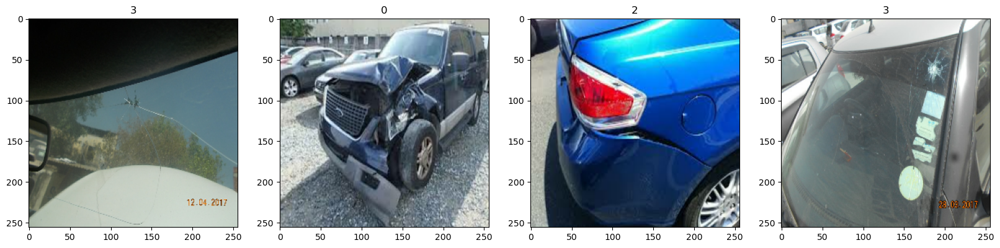

In [33]:
fig,ax=plt.subplots(ncols=4,figsize=(20,20))
for idx,img in enumerate(batch[0][:4]):
    ax[idx].imshow(img.astype(int))
    ax[idx].title.set_text(batch[1][idx])

Pre_Process Data

In [34]:
data=data.map(lambda x,y: (x/255 ,y))

In [35]:
data.as_numpy_iterator().next()

(array([[[[0.6192096 , 0.6545037 , 0.6819547 ],
          [0.57331496, 0.608701  , 0.6364277 ],
          [0.77429533, 0.813511  , 0.8527267 ],
          ...,
          [1.        , 1.        , 0.95340073],
          [0.988511  , 0.99617034, 0.9414522 ],
          [0.98045343, 0.98829657, 0.9333946 ]],
 
         [[0.6892408 , 0.7145862 , 0.73957926],
          [0.6576841 , 0.6880177 , 0.71818286],
          [0.83564585, 0.86746824, 0.9057086 ],
          ...,
          [0.98732024, 0.99711293, 0.94312036],
          [0.99065685, 0.99855024, 0.94609493],
          [0.9829504 , 0.99574834, 0.93838847]],
 
         [[0.83598906, 0.8463509 , 0.8622299 ],
          [0.8158402 , 0.8309137 , 0.85761094],
          [0.92119884, 0.93642557, 0.96121216],
          ...,
          [0.9735949 , 0.9920691 , 0.9351638 ],
          [0.993247  , 0.99983555, 0.9547513 ],
          [0.98592216, 1.        , 0.9474265 ]],
 
         ...,
 
         [[0.84931064, 0.71676505, 0.63201916],
          [0.83447

In [36]:
len(data) #represent batch size

40

In [37]:
train_size=int(len(data)*.7)-3
val_size=int(len(data)*.2)+2
test_size=int(len(data)*.1)+2

In [38]:
print(train_size,val_size,test_size)

25 10 6


In [39]:
train=data.take(train_size)
val=data.skip(train_size).take(val_size)
test=data.skip(train_size+val_size).take(test_size)

In [40]:
#Assuming 4 classes (adjust as needed)
num_classes = 4

# Image size
img_height, img_width = 256, 256

model = models.Sequential([
    layers.Conv2D(256, (3, 3), activation='relu', input_shape=(img_height, img_width, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(32, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(num_classes, activation='softmax')  # Multi-class classification, so using softmax activation
])

In [41]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 254, 254, 256)     7168      
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 127, 127, 256)    0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 125, 125, 128)     295040    
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 62, 62, 128)      0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 60, 60, 32)        36896     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 30, 30, 32)      

In [42]:
# Compile the model
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

TRAin model


In [43]:
logsdir='.\logs'

In [44]:
tensorboard_callback=tf.keras.callbacks.TensorBoard(log_dir=logsdir)

In [45]:
hist=model.fit(train,epochs=11,validation_data=val,callbacks=[tensorboard_callback])

Epoch 1/11
25/25 [==============================] - 8s 172ms/step - loss: 1.5123 - accuracy: 0.3450 - val_loss: 1.3686 - val_accuracy: 0.3625
Epoch 2/11
25/25 [==============================] - 4s 162ms/step - loss: 1.3361 - accuracy: 0.3925 - val_loss: 1.3453 - val_accuracy: 0.3187
Epoch 3/11
25/25 [==============================] - 4s 160ms/step - loss: 1.2869 - accuracy: 0.3825 - val_loss: 1.3154 - val_accuracy: 0.3438
Epoch 4/11
25/25 [==============================] - 4s 160ms/step - loss: 1.2022 - accuracy: 0.4175 - val_loss: 1.2013 - val_accuracy: 0.4500
Epoch 5/11
25/25 [==============================] - 4s 160ms/step - loss: 1.1808 - accuracy: 0.4975 - val_loss: 1.2328 - val_accuracy: 0.4500
Epoch 6/11
25/25 [==============================] - 4s 159ms/step - loss: 1.0864 - accuracy: 0.5775 - val_loss: 1.2987 - val_accuracy: 0.4750
Epoch 7/11
25/25 [==============================] - 4s 159ms/step - loss: 1.0165 - accuracy: 0.5850 - val_loss: 1.2908 - val_accuracy: 0.4625
Epoch 

In [46]:
hist.history

{'loss': [1.5123062133789062,
  1.3361341953277588,
  1.2868717908859253,
  1.202226161956787,
  1.1808282136917114,
  1.086444616317749,
  1.016532301902771,
  0.9499346017837524,
  0.742745041847229,
  0.648837149143219,
  0.48189273476600647],
 'accuracy': [0.3449999988079071,
  0.39250001311302185,
  0.3824999928474426,
  0.41749998927116394,
  0.4975000023841858,
  0.5774999856948853,
  0.5849999785423279,
  0.6424999833106995,
  0.6875,
  0.7774999737739563,
  0.8450000286102295],
 'val_loss': [1.368553876876831,
  1.3453086614608765,
  1.315431833267212,
  1.201251745223999,
  1.2328424453735352,
  1.2986682653427124,
  1.2907626628875732,
  1.295191764831543,
  1.3529456853866577,
  1.0852909088134766,
  1.084911823272705],
 'val_accuracy': [0.36250001192092896,
  0.3187499940395355,
  0.34375,
  0.44999998807907104,
  0.44999998807907104,
  0.4749999940395355,
  0.4625000059604645,
  0.518750011920929,
  0.581250011920929,
  0.6000000238418579,
  0.625]}

PLOT Performance

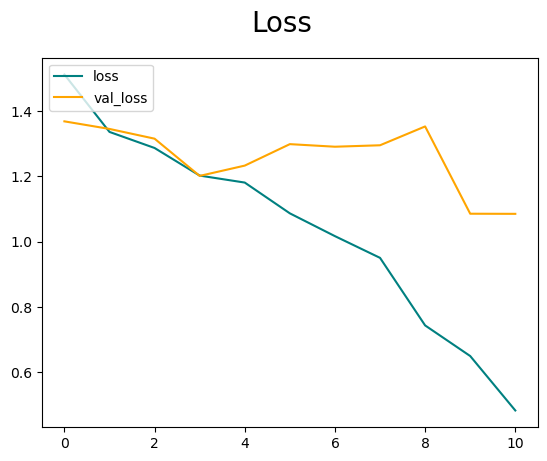

In [47]:
fig=plt.figure()
plt.plot(hist.history['loss'],color='teal',label='loss')
plt.plot(hist.history['val_loss'],color='orange',label='val_loss')
fig.suptitle('Loss',fontsize=20)
plt.legend(loc="upper left")
plt.show()

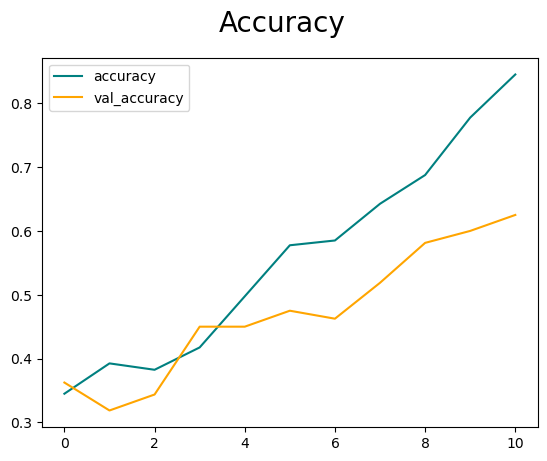

In [48]:
fig=plt.figure()
plt.plot(hist.history['accuracy'],color='teal',label='accuracy')
plt.plot(hist.history['val_accuracy'],color='orange',label='val_accuracy')
fig.suptitle('Accuracy',fontsize=20)
plt.legend(loc="upper left")
plt.show()

Evaluate Performance


In [49]:
#For confusion matrix
import numpy as np
from sklearn.metrics import confusion_matrix
import seaborn as sns

true_labels = []
predicted_labels = []

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    yhat_classes = np.argmax(yhat, axis=1)
    true_labels.extend(y)
    predicted_labels.extend(yhat_classes)

true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

1/1 [==============================] - 1s 646ms/step


Confusion Matrix:
[[17  5  7  3]
 [ 5  9  3  0]
 [ 5  2  6  0]
 [ 2  1  1  8]]


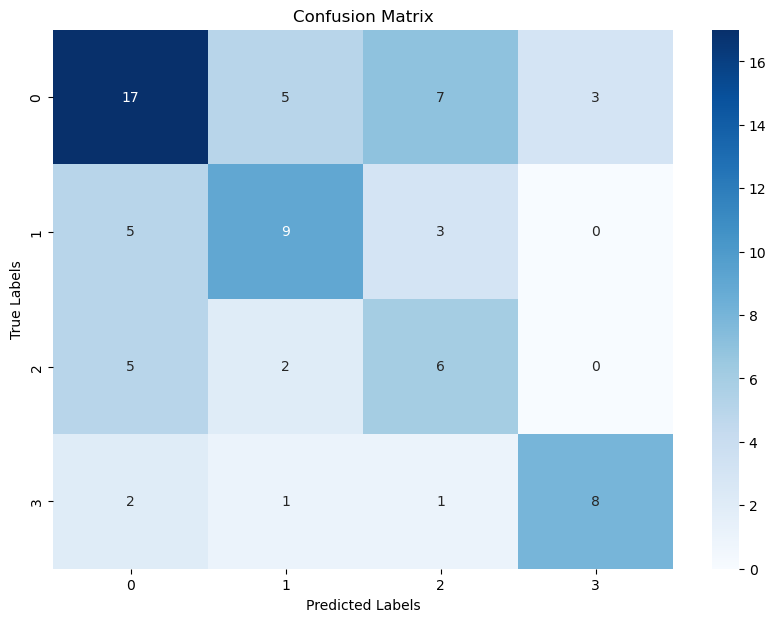

In [50]:
# Compute the confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Print the confusion matrix
print("Confusion Matrix:")
print(cm)

# Plot the confusion matrix using Seaborn for better visualization
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', xticklabels=True, yticklabels=True)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

In [51]:
from tensorflow.keras.metrics import Precision,Recall,SparseCategoricalAccuracy,CategoricalAccuracy

In [52]:
pre=Precision()
re=Recall()
acc=CategoricalAccuracy()

In [53]:
pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)
    print(y.shape)
    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    for actual, predicted in zip(y, yhat_classes):
        print(f"Actual: {actual}, Predicted: {predicted}")
    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y, yhat_classes)
    re.update_state(y, yhat_classes)
    acc.update_state(y, yhat_classes)


1/1 [==============================] - 0s 32ms/step
(16,)
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 1, Predicted: 3
Actual: 0, Predicted: 3
Actual: 0, Predicted: 3
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 0, Predicted: 0
Actual: 3, Predicted: 0
Actual: 0, Predicted: 2
Actual: 2, Predicted: 2
Actual: 0, Predicted: 0
Actual: 0, Predicted: 3
Actual: 0, Predicted: 1
Actual: 0, Predicted: 0
Actual: 2, Predicted: 2
1/1 [==============================] - 0s 34ms/step
(16,)
Actual: 0, Predicted: 0
Actual: 0, Predicted: 2
Actual: 1, Predicted: 1
Actual: 2, Predicted: 2
Actual: 1, Predicted: 1
Actual: 1, Predicted: 0
Actual: 0, Predicted: 1
Actual: 3, Predicted: 0
Actual: 3, Predicted: 0
Actual: 2, Predicted: 2
Actual: 0, Predicted: 0
Actual: 2, Predicted: 0
Actual: 0, Predicted: 0
Actual: 1, Predicted: 1
Actual: 3, Predicted: 3
Actual: 0, Predicted: 1
1/1 [==============================] - 0s 32ms/step
(16,)
Actual: 1, Predicted: 1
Actual: 2, Predicted: 0
Actual: 1,

1/1 [==============================] - 0s 32ms/step
Actual: 1, Predicted: 1


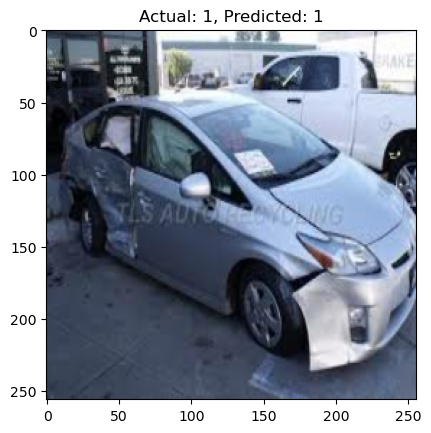

Actual: 2, Predicted: 2


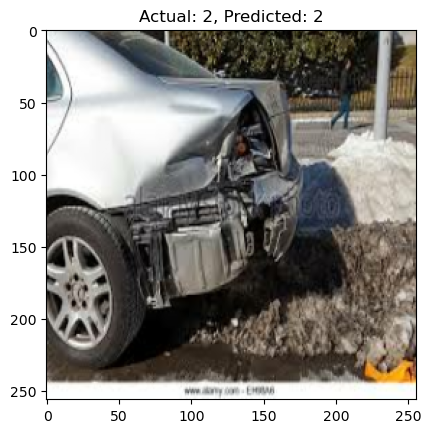

Actual: 2, Predicted: 0


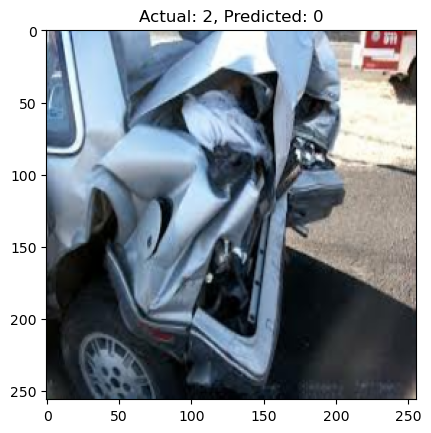

Actual: 0, Predicted: 0


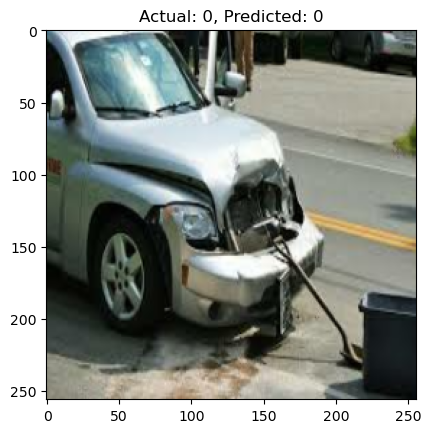

Actual: 1, Predicted: 1


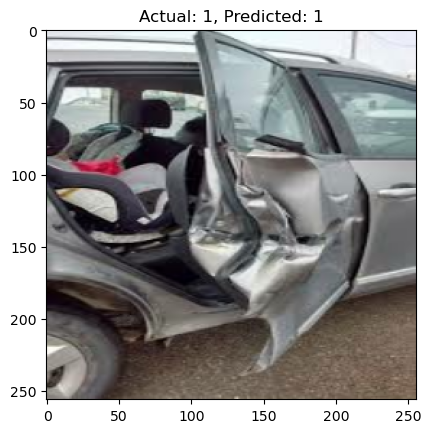

Actual: 1, Predicted: 1


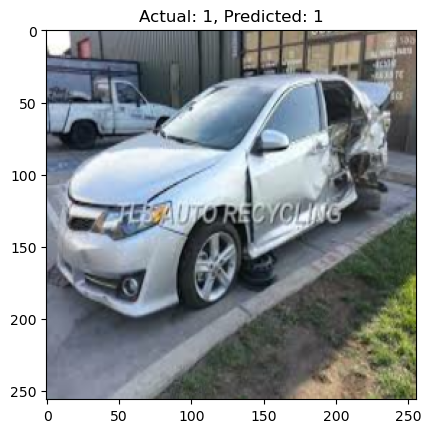

Actual: 3, Predicted: 2


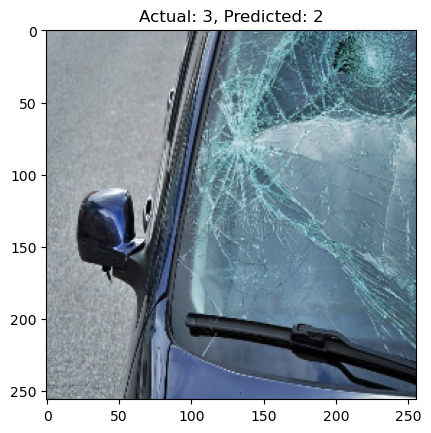

Actual: 3, Predicted: 3


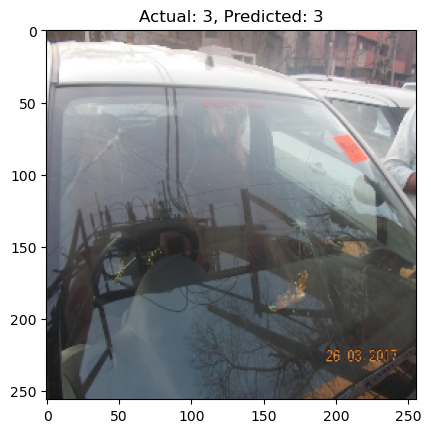

Actual: 2, Predicted: 2


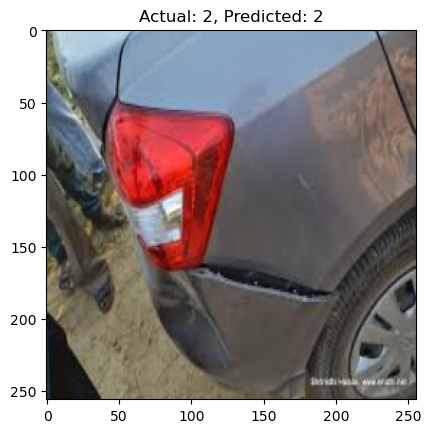

Actual: 1, Predicted: 0


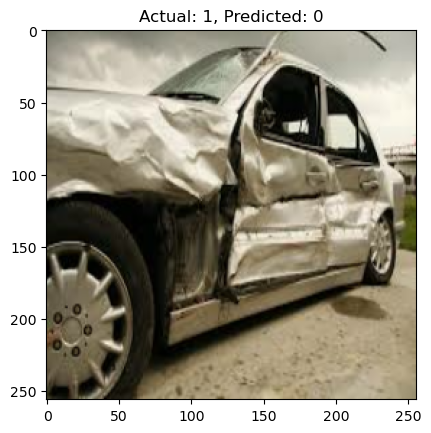

Actual: 0, Predicted: 0


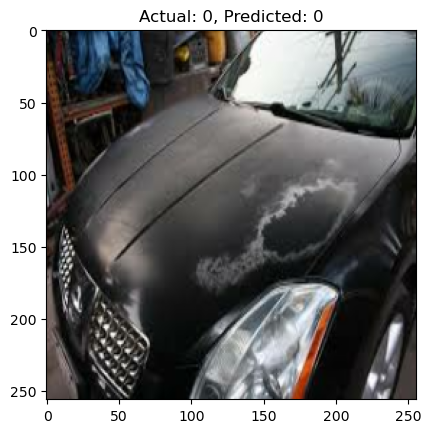

Actual: 1, Predicted: 0


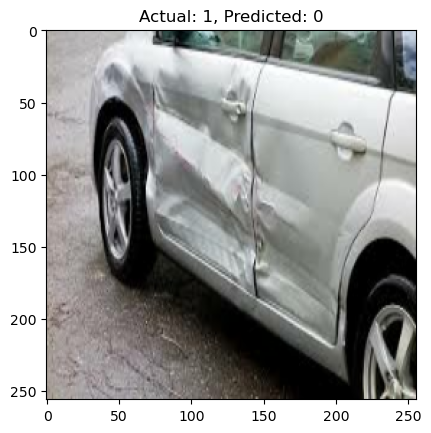

Actual: 1, Predicted: 2


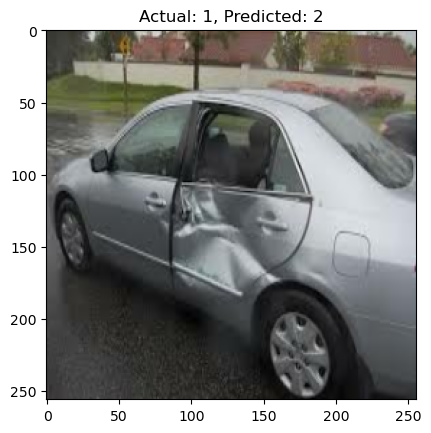

Actual: 0, Predicted: 2


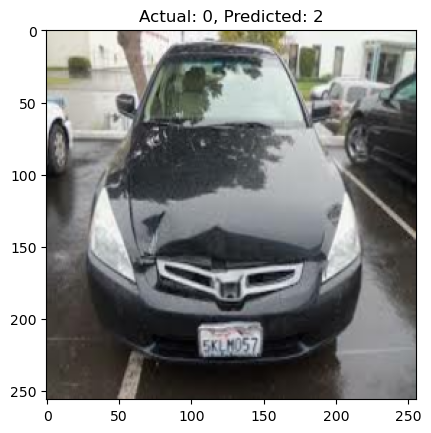

Actual: 0, Predicted: 2


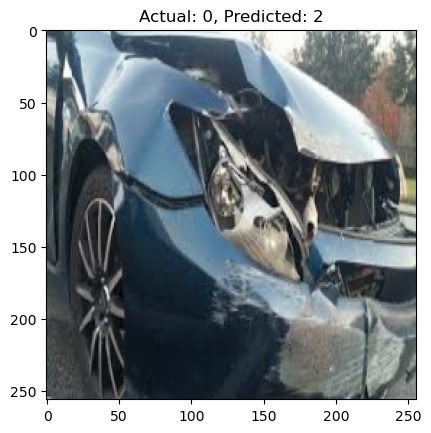

Actual: 1, Predicted: 1


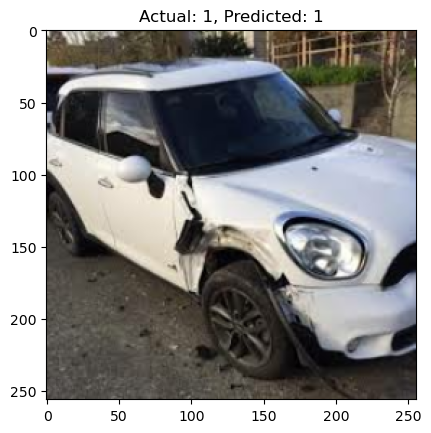

(16,) (16,)
1/1 [==============================] - 0s 35ms/step
Actual: 1, Predicted: 1


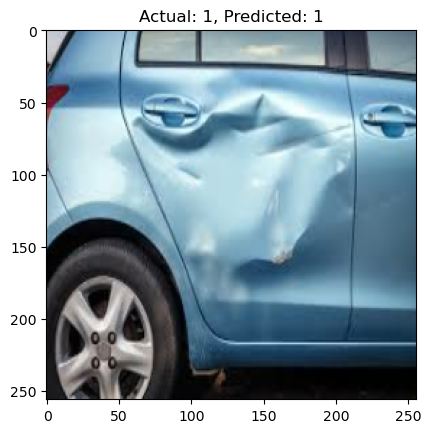

Actual: 3, Predicted: 3


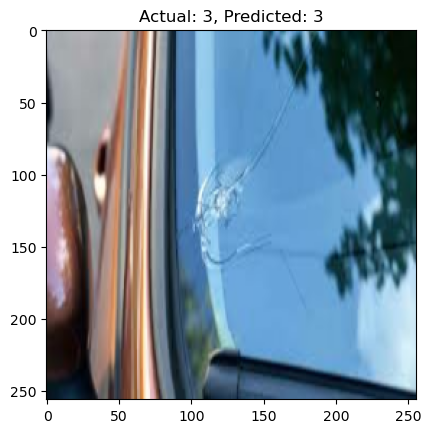

Actual: 0, Predicted: 0


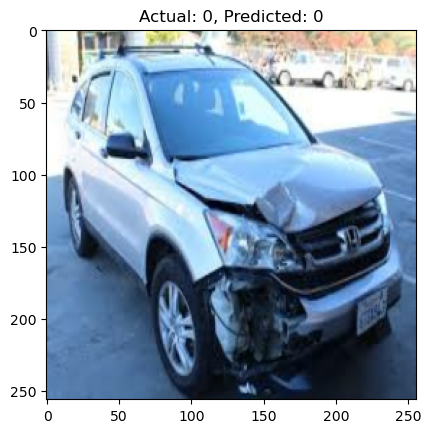

Actual: 0, Predicted: 2


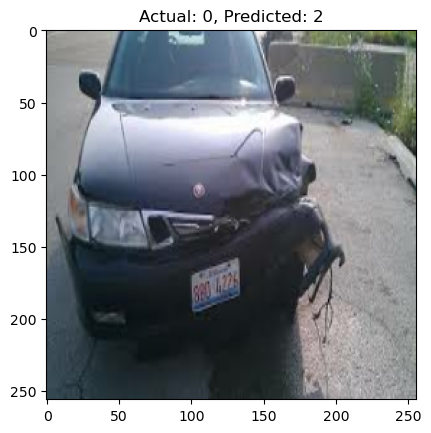

Actual: 0, Predicted: 0


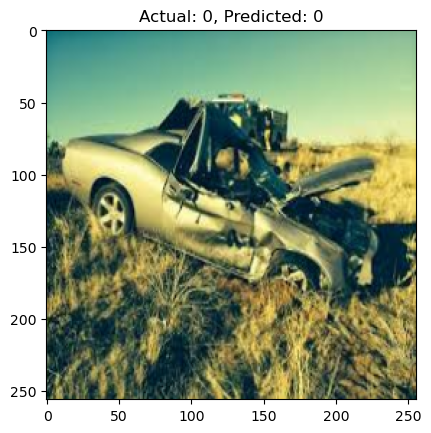

Actual: 0, Predicted: 3


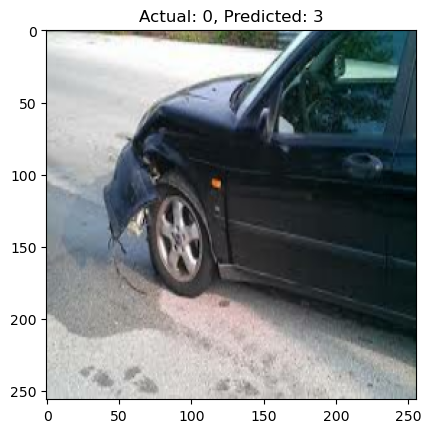

Actual: 0, Predicted: 0


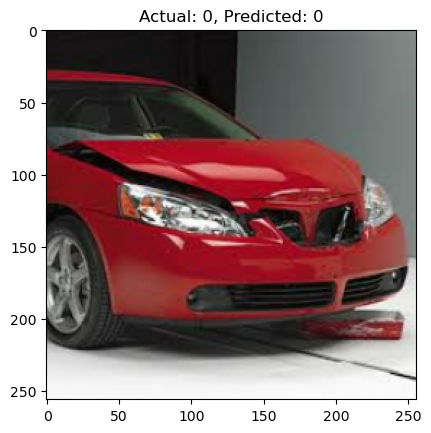

Actual: 2, Predicted: 2


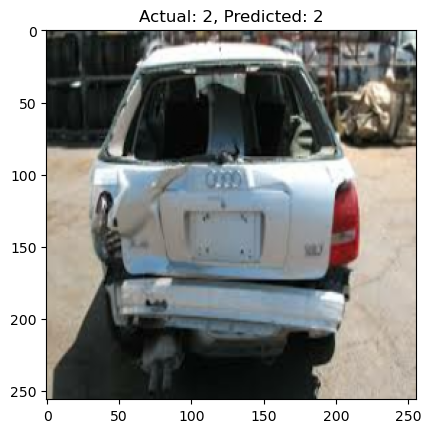

Actual: 3, Predicted: 3


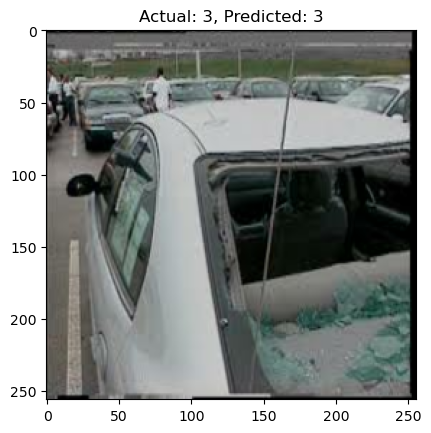

Actual: 2, Predicted: 2


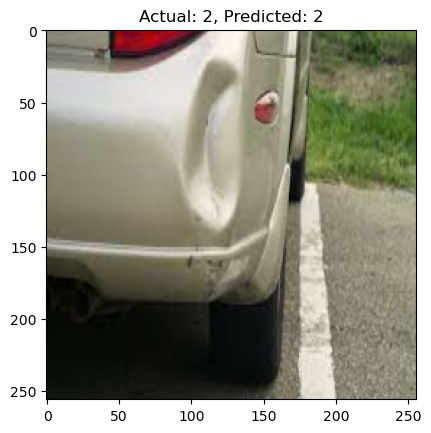

Actual: 1, Predicted: 1


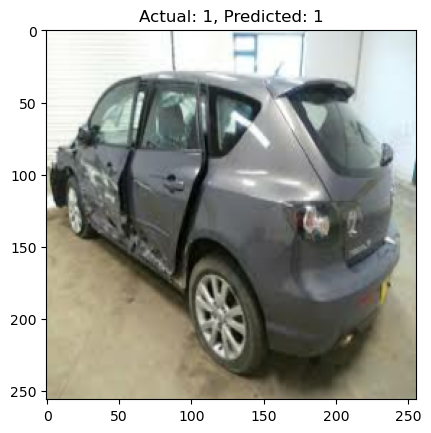

Actual: 3, Predicted: 2


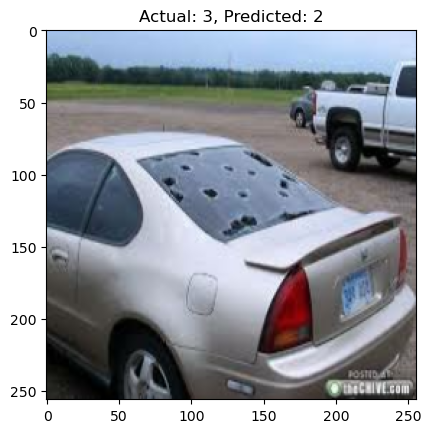

Actual: 0, Predicted: 0


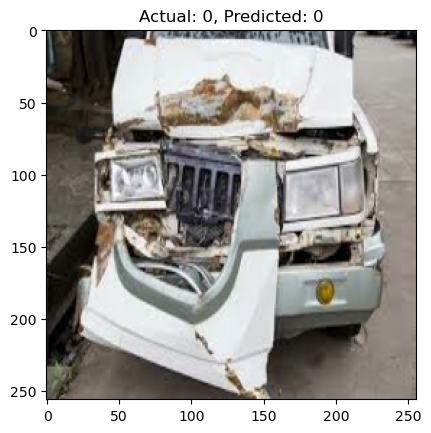

Actual: 0, Predicted: 3


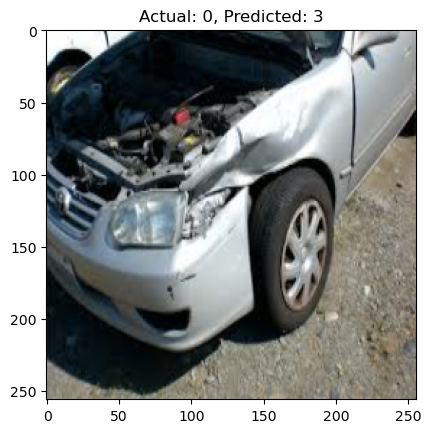

Actual: 2, Predicted: 0


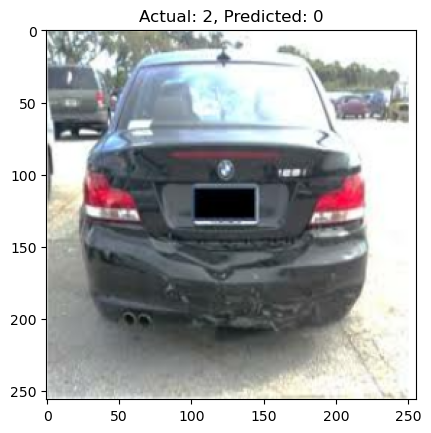

Actual: 2, Predicted: 2


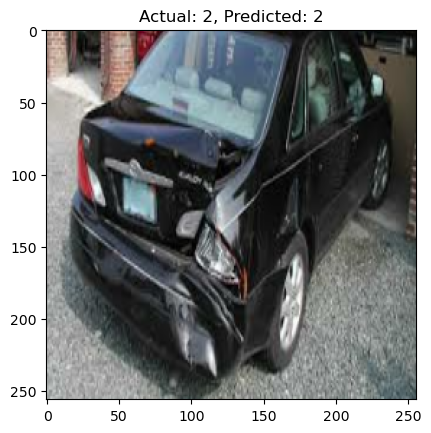

(16,) (16,)
1/1 [==============================] - 0s 35ms/step
Actual: 1, Predicted: 1


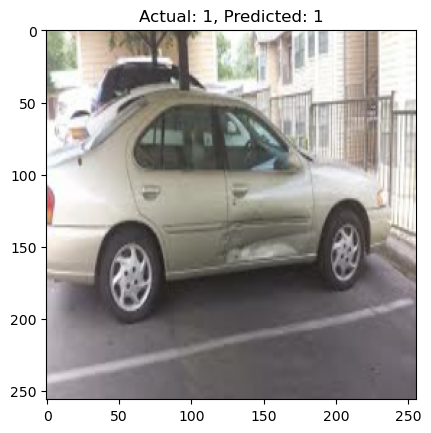

Actual: 3, Predicted: 3


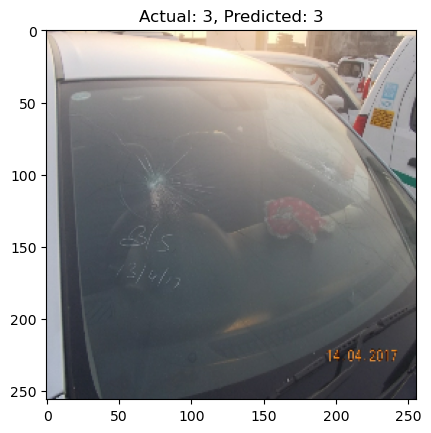

Actual: 0, Predicted: 0


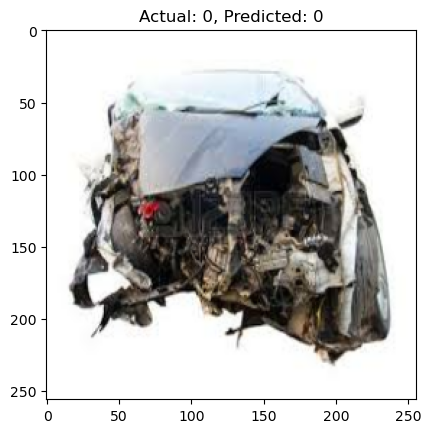

Actual: 3, Predicted: 0


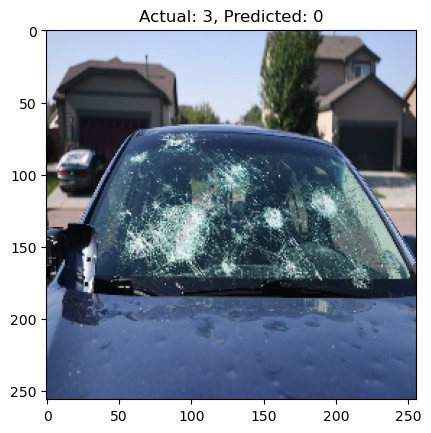

Actual: 0, Predicted: 0


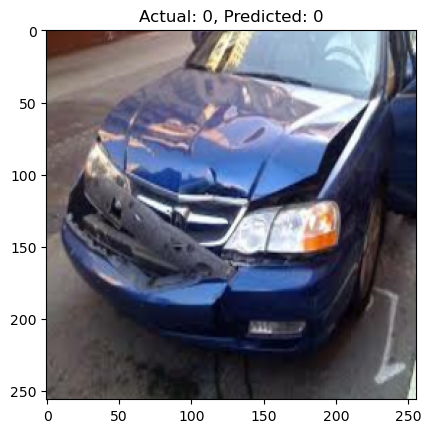

Actual: 0, Predicted: 0


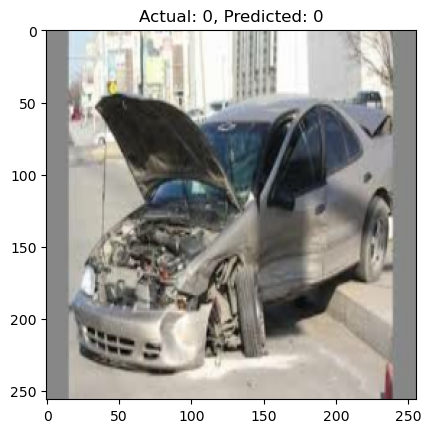

Actual: 1, Predicted: 3


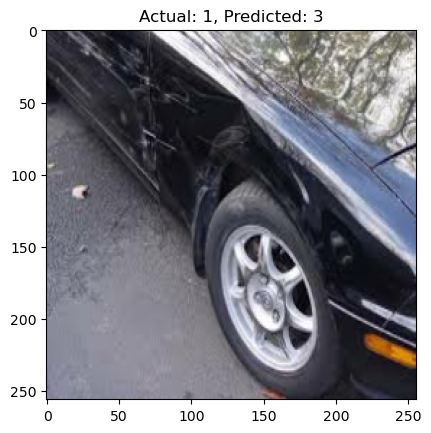

Actual: 2, Predicted: 3


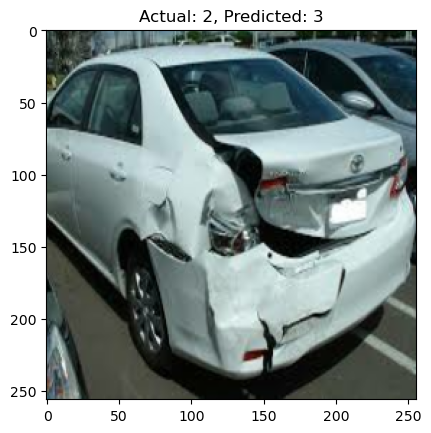

Actual: 0, Predicted: 0


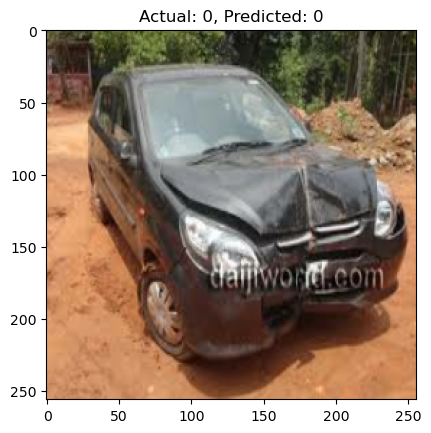

Actual: 0, Predicted: 3


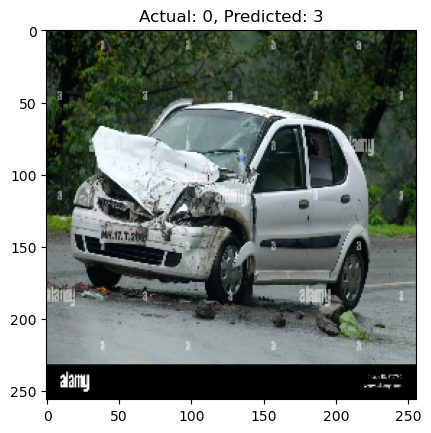

Actual: 1, Predicted: 3


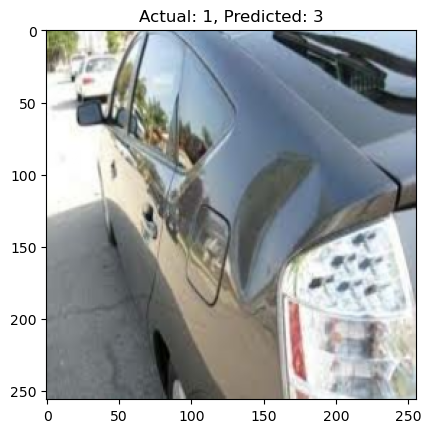

Actual: 0, Predicted: 1


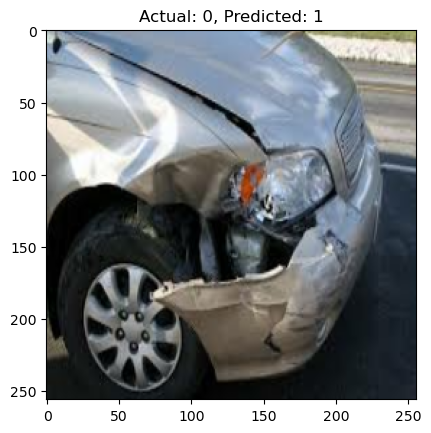

Actual: 3, Predicted: 0


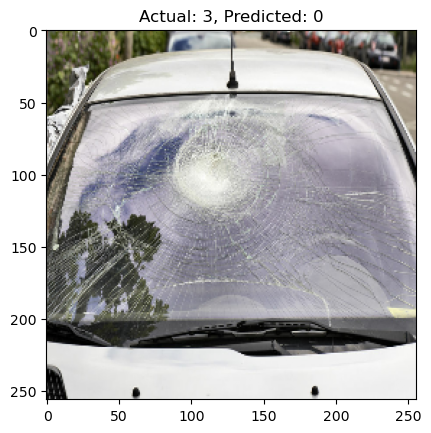

Actual: 2, Predicted: 0


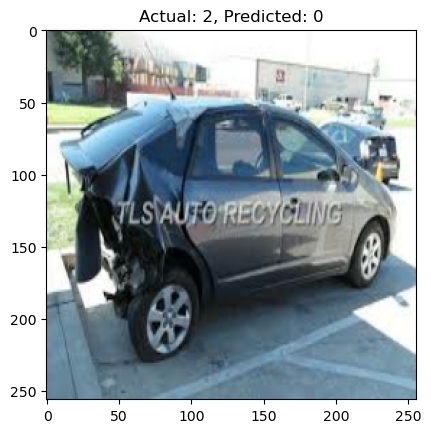

Actual: 2, Predicted: 1


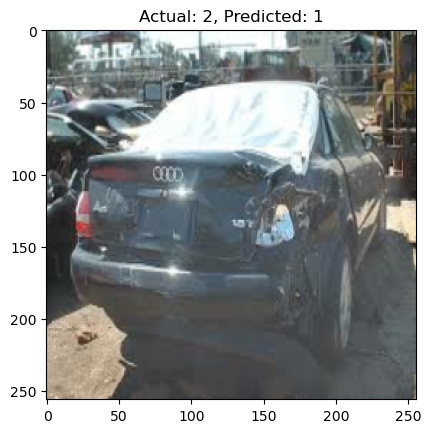

Actual: 0, Predicted: 2


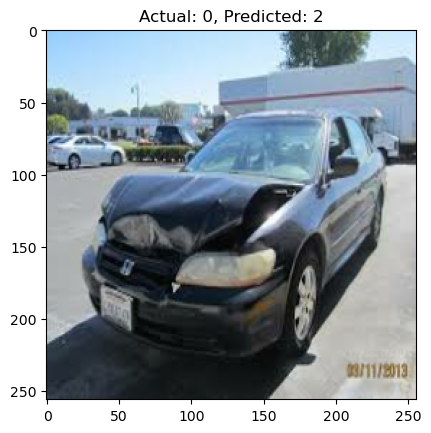

(16,) (16,)
1/1 [==============================] - 0s 42ms/step
Actual: 0, Predicted: 0


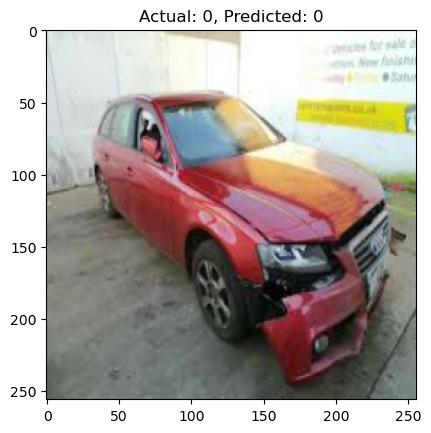

Actual: 0, Predicted: 0


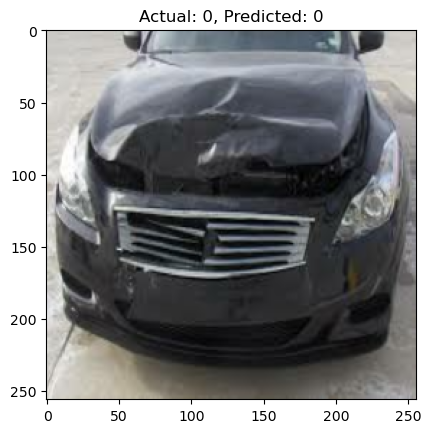

Actual: 3, Predicted: 3


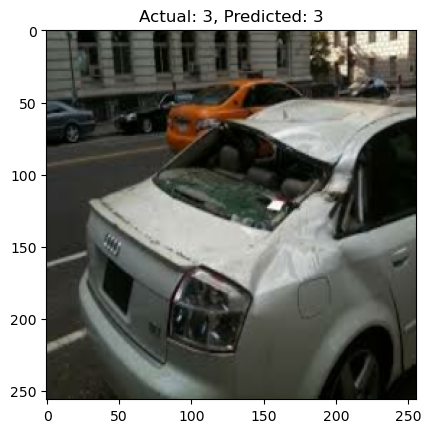

Actual: 0, Predicted: 0


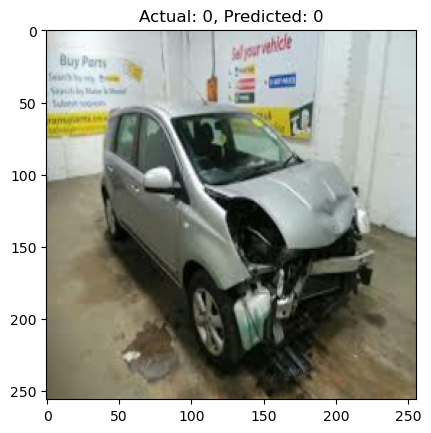

Actual: 3, Predicted: 0


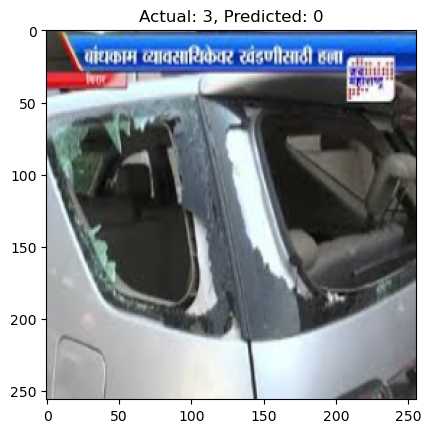

Actual: 0, Predicted: 0


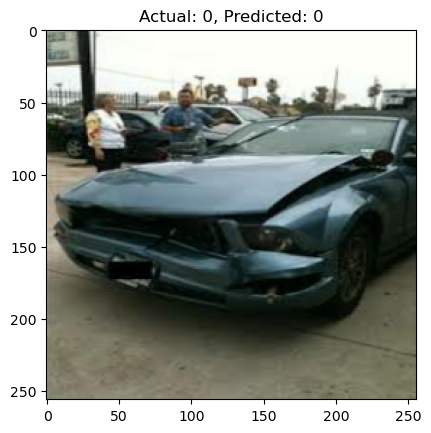

Actual: 3, Predicted: 3


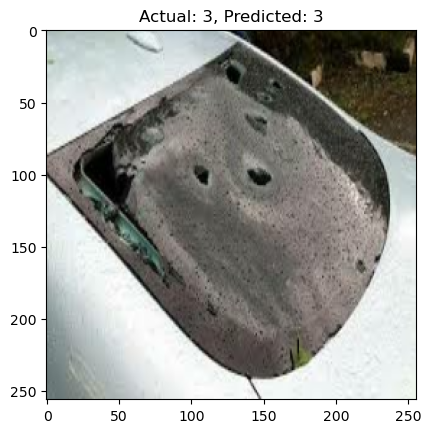

Actual: 2, Predicted: 0


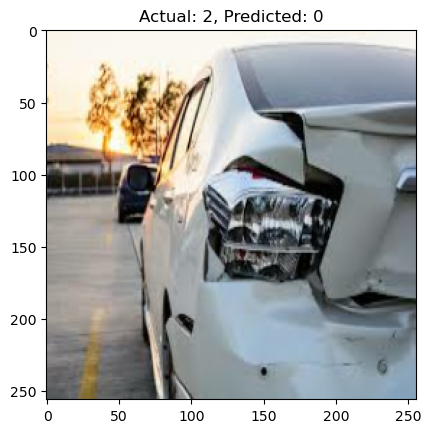

Actual: 1, Predicted: 2


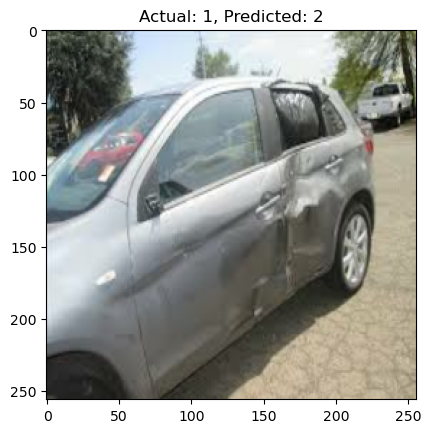

Actual: 0, Predicted: 2


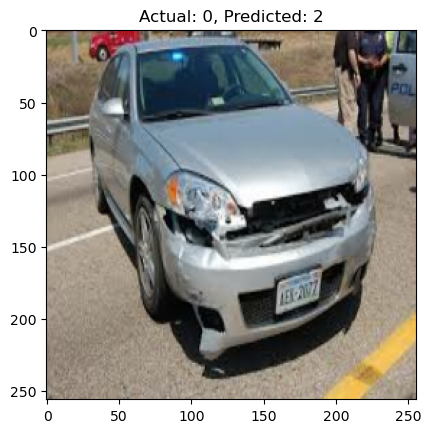

Actual: 0, Predicted: 0


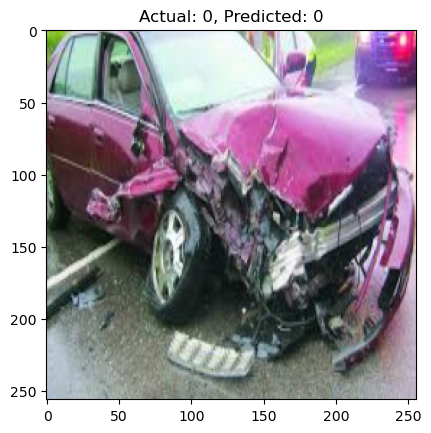

Actual: 3, Predicted: 0


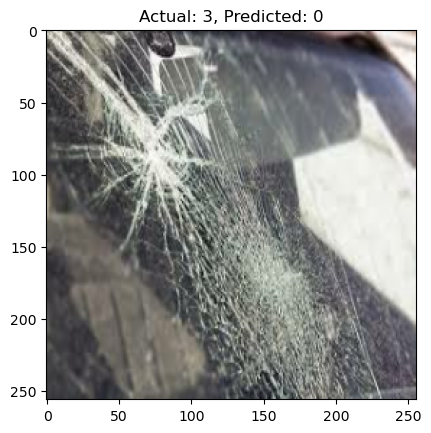

Actual: 2, Predicted: 2


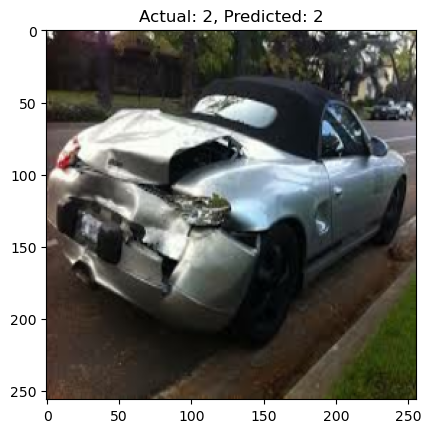

Actual: 0, Predicted: 2


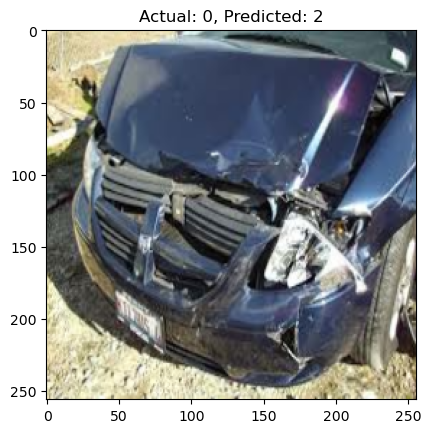

Actual: 0, Predicted: 0


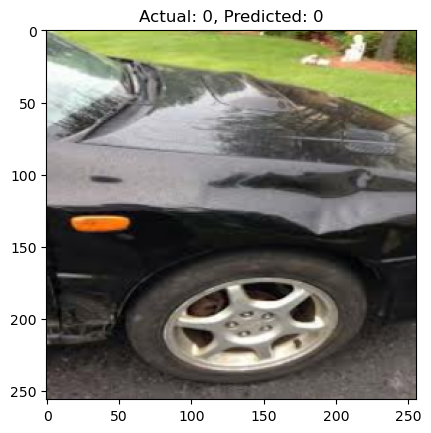

Actual: 0, Predicted: 0


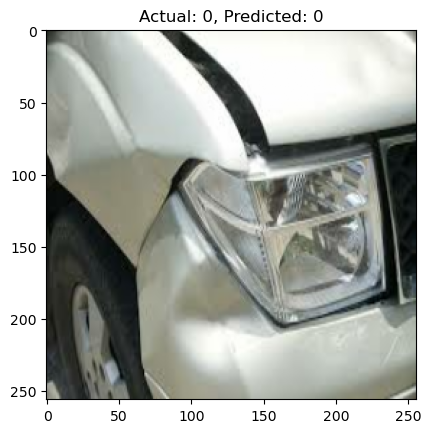

(16,) (16,)
1/1 [==============================] - 0s 54ms/step
Actual: 0, Predicted: 0


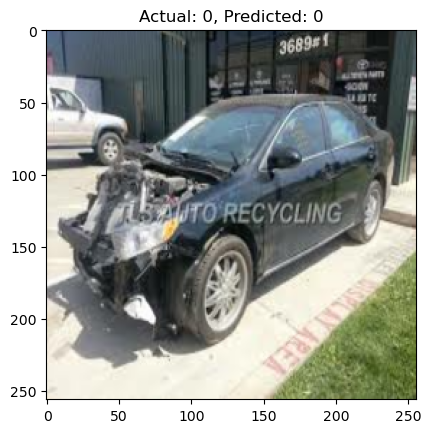

Actual: 1, Predicted: 0


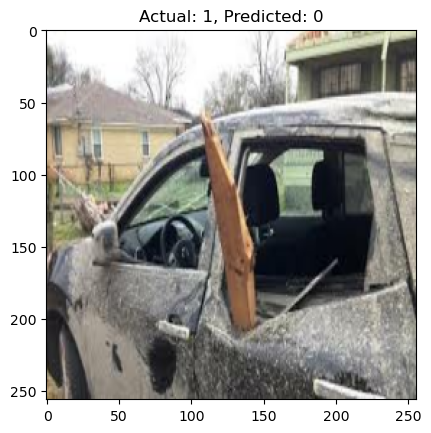

Actual: 2, Predicted: 0


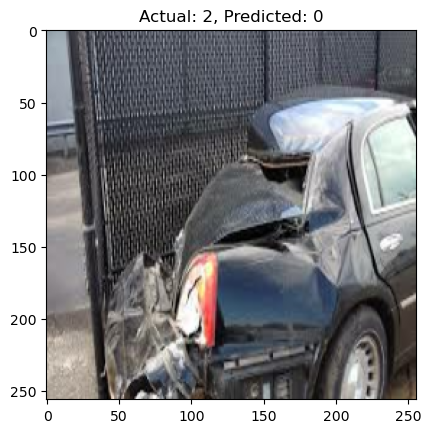

Actual: 3, Predicted: 0


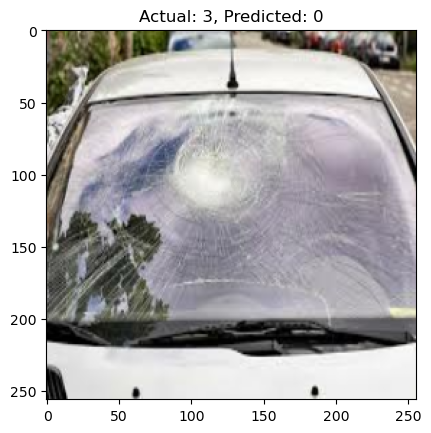

Actual: 1, Predicted: 2


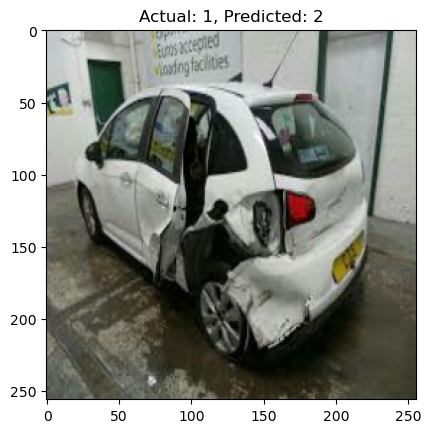

Actual: 3, Predicted: 0


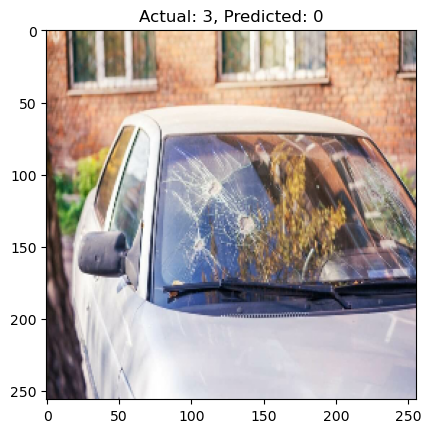

Actual: 0, Predicted: 2


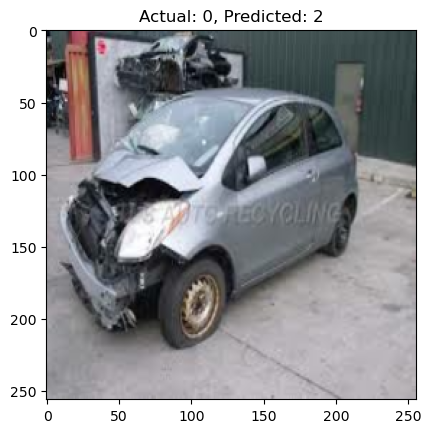

Actual: 0, Predicted: 0


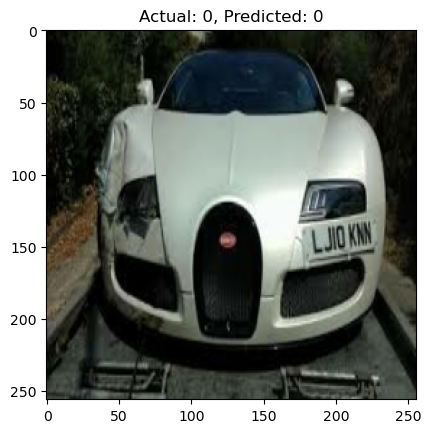

Actual: 0, Predicted: 0


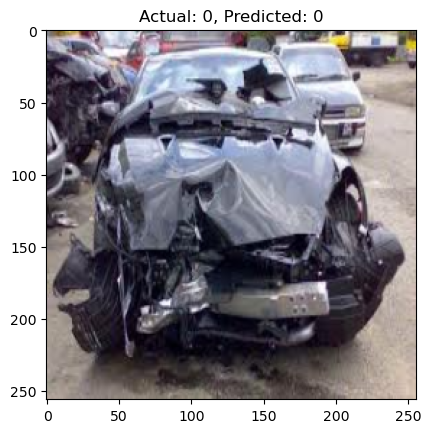

Actual: 0, Predicted: 0


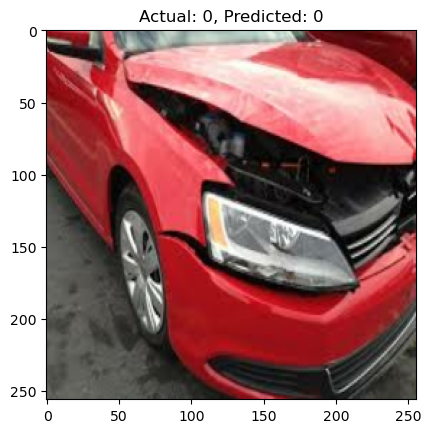

(10,) (10,)


In [54]:


pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)

    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    for i in range(len(y)):
        actual = y[i]
        predicted = yhat_classes[i]

        # Print actual and predicted labels
        print(f"Actual: {actual}, Predicted: {predicted}")

        # Display the image
        plt.imshow(X[i])
        plt.title(f"Actual: {actual}, Predicted: {predicted}")
        plt.show()
    print(y.shape,yhat_classes.shape)
    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y, yhat_classes)
    re.update_state(y, yhat_classes)
    acc.update_state(y, yhat_classes)




In [55]:
pre.reset_state()
re.reset_state()
acc.reset_state()

for batch in test.as_numpy_iterator():
    X, y = batch
    yhat = model.predict(X)

    # Get predicted classes
    yhat_classes = np.argmax(yhat, axis=1)

    # One-hot encode the labels
    y_one_hot = tf.keras.utils.to_categorical(y, num_classes=num_classes)


    for i in range(len(y)):
        actual = y_one_hot[i]
        predicted = tf.one_hot(yhat_classes[i], depth=num_classes)

        # Print actual and predicted labels
        print(f"Actual: {actual}, Predicted: {predicted}")

        # Display the image
        # plt.imshow(X[i])
        # plt.title(f"Actual: {actual}, Predicted: {predicted}")
        # plt.show()

    # Assuming 'pre', 're', 'acc' are instances of metrics classes
    pre.update_state(y_one_hot, yhat)
    re.update_state(y_one_hot, yhat)
    acc.update_state(y_one_hot, yhat)

pre_result = pre.result().numpy()
re_result = re.result().numpy()
acc_result = acc.result().numpy()

print(f'Precision: {pre_result}, Recall: {re_result}, Accuracy: {acc_result}')


1/1 [==============================] - 0s 40ms/step
Actual: [0. 0. 0. 1.], Predicted: [0. 0. 0. 1.]
Actual: [0. 0. 0. 1.], Predicted: [0. 0. 0. 1.]
Actual: [1. 0. 0. 0.], Predicted: [0. 0. 1. 0.]
Actual: [0. 0. 1. 0.], Predicted: [0. 0. 1. 0.]
Actual: [0. 0. 1. 0.], Predicted: [0. 0. 0. 1.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [0. 1. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [0. 0. 1. 0.], Predicted: [0. 0. 0. 1.]
Actual: [0. 1. 0. 0.], Predicted: [0. 1. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [0. 0. 0. 1.], Predicted: [0. 1. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [0. 0. 1. 0.]
Actual: [0. 1. 0. 0.], Predicted: [0. 0. 0. 1.]
Actual: [0. 0. 1. 0.], Predicted: [0. 0. 0. 1.]
Actual: [0. 0. 0. 1.], Predicted: [0. 0. 0. 1.]
Actual: [0. 1. 0. 0.], Predicted: [0. 1. 0. 0.]
1/1 [==============================] - 0s 34ms/step
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted: [1. 0. 0. 0.]
Actual: [1. 0. 0. 0.], Predicted

In [56]:
print(f"Precision:{pre.result().numpy()}, Recall:{re.result().numpy()}, Accuracy:{acc.result().numpy()}")

Precision:0.71875, Recall:0.6216216087341309, Accuracy:0.6486486196517944


Test

In [57]:
import cv2

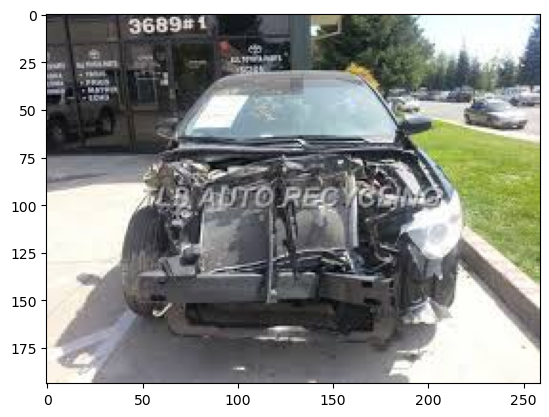

In [58]:
img=cv2.imread('test_image_1.jpeg')
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.show()

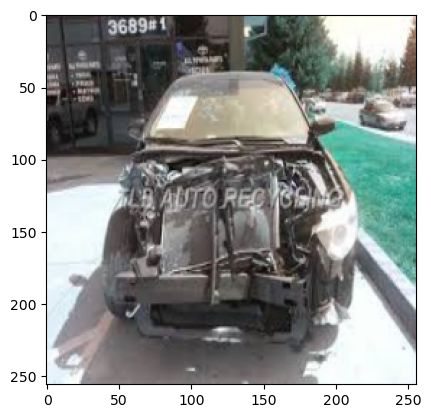

In [59]:
resize=tf.image.resize(img,(256,256))
plt.imshow(resize.numpy().astype(int))
plt.show()

In [60]:
yhat=model.predict(np.expand_dims(resize/255,0))

1/1 [==============================] - 0s 237ms/step


In [61]:
predicted_class = np.argmax(yhat)
print(f'Predicted Class: {predicted_class}')

Predicted Class: 0


In [62]:
# Define the path where you want to save the model
model_path = "../DEPLOY_MODEL1/model2.h5"

# Save the model to the specified path
model.save(model_path)


In [63]:
# # Define the path where you want to save the model
# model_path = "../DEPLOY_MODEL1/model2.h5"

# # Save the model to the specified path
# model.save(model_path)